#### **Install Packages**

In [1]:
# %%capture
# !pip install pandas numpy matplotlib scikit-image tqdm gdown opencv-python plotly pillow scikit-learn
# !pip install nbformat --upgrade
# !pip install --upgrade jupyter ipywidgets
!pip install pyimagej scyjava


#### **Import modules**

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from glob import glob
import skimage.io as skio
from skimage.color import rgb2gray, rgba2rgb, hsv2rgb
from tqdm.notebook import tqdm as tqdm
from skimage.transform import resize
import os
import gdown
import cv2

import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots

from PIL import Image


#### **Prepare file**

#### **Load Images**

In [3]:
def glob_filepath(folder, ext, subfolder=False):
    """
    Get all the filepaths of a folder with a given extension without case sensitivity
    Args: folder -> the folder to search
          ext -> the extension of the files to search for
          subfolder -> whether to include subfolders in the search
    Return: list of filepaths
    """
    filepath = []

    if folder[-1] != '/' and folder != '':
        folder += '/'

    if not isinstance(ext, list):
        ext = [ext]

    if subfolder:
        folder = os.path.join(folder, '**')

    for item in ext:
        # Using glob with case-insensitive patterns
        filepath += glob(os.path.join(folder, '*.' + item), recursive=subfolder)
        filepath += glob(os.path.join(folder, '*.' + item.upper()), recursive=subfolder)
        filepath += glob(os.path.join(folder, '*.' + item.lower()), recursive=subfolder)
    
    return sorted(list(set(filepath)))


In [4]:

filepaths = glob_filepath(folder='../data/data_v1', ext=['jpg', 'png', 'jpeg'], subfolder=True)
print(filepaths)

['../data/data_v1/pistachio24_BACK(1) (1).JPG', '../data/data_v1/pistachio24_BACK(1) (1).png', '../data/data_v1/pistachio24_BACK(1) (1)/pistachio_1.png', '../data/data_v1/pistachio24_BACK(1) (1)/pistachio_10.png', '../data/data_v1/pistachio24_BACK(1) (1)/pistachio_100.png', '../data/data_v1/pistachio24_BACK(1) (1)/pistachio_101.png', '../data/data_v1/pistachio24_BACK(1) (1)/pistachio_102.png', '../data/data_v1/pistachio24_BACK(1) (1)/pistachio_103.png', '../data/data_v1/pistachio24_BACK(1) (1)/pistachio_104.png', '../data/data_v1/pistachio24_BACK(1) (1)/pistachio_105.png', '../data/data_v1/pistachio24_BACK(1) (1)/pistachio_106.png', '../data/data_v1/pistachio24_BACK(1) (1)/pistachio_107.png', '../data/data_v1/pistachio24_BACK(1) (1)/pistachio_108.png', '../data/data_v1/pistachio24_BACK(1) (1)/pistachio_109.png', '../data/data_v1/pistachio24_BACK(1) (1)/pistachio_11.png', '../data/data_v1/pistachio24_BACK(1) (1)/pistachio_110.png', '../data/data_v1/pistachio24_BACK(1) (1)/pistachio_111.

In [5]:
def read_image(filepath, show_image=True, return_arr=True):
  try:
    img = skio.imread(filepath)
    if show_image:
      skio.imshow(img)
  except:
    img = Image.open(filepaths[0])
    img_arr = np.array(img)
    if show_image:
      display(img)
    img = img_arr
  if return_arr:
    return(img)



#### **Load Sample Image**

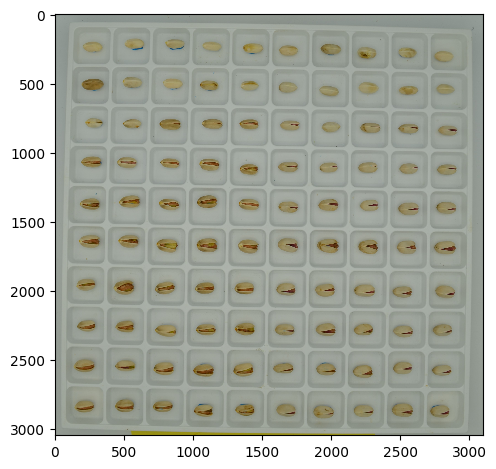

In [6]:
img = read_image(filepath=filepaths[0], show_image=True, return_arr=True)
fig = px.imshow(img)

##### **Crop out Pistachios**

In [7]:
def sort_contours(contours, y_overlap_threshold=2, sort_by_topmost=False):
    # Group contours into rows based on y-coordinate overlap
    def group_into_rows(contours):
        rows = []
        current_row = [contours[0]]
        for contour in contours[1:]:
            _, current_y, _, current_h = cv2.boundingRect(current_row[-1])
            _, next_y, _, next_h = cv2.boundingRect(contour)
            
            # Check if the contour belongs to the current row
            if min(current_y + current_h, next_y + next_h) - max(current_y, next_y) > y_overlap_threshold:
                current_row.append(contour)
            else:
                rows.append(current_row)
                current_row = [contour]
        
        rows.append(current_row)
        return rows

    # Sort contours in each row based on x-coordinate
    def sort_row(row):
        return sorted(row, key=lambda contour: cv2.boundingRect(contour)[0])

    if sort_by_topmost:
        # Sort contours based on the top y-coordinate
        sorted_contours = sorted(contours, key=lambda contour: cv2.boundingRect(contour)[1])
    else:
        # First group contours into rows, then sort each row
        contours.sort(key=lambda contour: cv2.boundingRect(contour)[1]) # Sort by top y-coordinate
        rows = group_into_rows(contours)
        sorted_contours = [contour for row in rows for contour in sort_row(row)]

    return sorted_contours


In [8]:
from copy import deepcopy

import shutil

from sklearn.cluster import DBSCAN

def get_valid_contours(contours):
    """
    Separate valid and invalid contours based on their sizes.

    Parameters:
    contours (list): A list of contours to be separated.

    Returns:
    tuple: A tuple containing two lists: valid_contours and invalid_contours.
    """

    areas = []
    valid_contours = []
    invalid_contours = []

    for contour in contours:
        
        x, y, w, h = cv2.boundingRect(contour)
        areas.append([w, h]) 

    areas_np = np.array(areas)

    db = DBSCAN(eps=0.5, min_samples=2, metric='euclidean').fit(areas_np)
    labels = db.labels_

    # Separate the contours based on the clustering
    for i, label in enumerate(labels):
        if label == -1:  # DBSCAN labels noise (outliers) as -1, assuming noise points are invalid contours
            invalid_contours.append(contours[i])
        else:
            valid_contours.append(contours[i])

    return valid_contours, invalid_contours

In [9]:

from sklearn.decomposition import PCA

def fit_pca(coordinates, n_components=2, pt1=None, pt2=None):
    pca_cord = pd.DataFrame(coordinates, columns=['y', 'x'])
    pca = PCA(n_components=n_components)
    pca.fit(coordinates)
    pca_coordinates = pca.transform(coordinates)
    pca_cord['pca_y'] = pca_coordinates[:, 0]
    pca_cord['pca_x'] = pca_coordinates[:, 1]

    points_pd = []
    for points in [pt1, pt2]:
        if points is not None:
            points = np.array(points)
            pca_cord_array = pca_cord[['y', 'x']].to_numpy()
            matches = np.all(pca_cord_array[:, None] == points, axis=2)
            mask = np.any(matches, axis=1)
            selected_points = pca_cord[mask]
            points_pd.append(selected_points)
    points_pd = pd.concat(points_pd).reset_index(drop=True)
    tip_pd = points_pd.loc[points_pd['pca_y'].idxmax()]
    point = tip_pd[['y', 'x']].astype('int').values.tolist()
    return point

def distance(pt1, pt2):
    return np.sqrt((pt1[0] - pt2[0])**2 + (pt1[1] - pt2[1])**2)
def find_extreme_points(coordinates):
    
    hull = cv2.convexHull(coordinates)

    # Function to calculate distance

    # Initialize maximum distance and corresponding points
    max_distance = 0
    point1 = None
    point2 = None

    # Iterate over all edges of the convex hull
    for i in range(len(hull)):
        for j in range(len(hull)):
            dist = distance(hull[i][0], hull[j][0])
            if dist > max_distance:
                max_distance = dist
                point1 = hull[i][0]
                point2 = hull[j][0]

    return point1, point2

In [10]:
    
def adjust_brightness_contrast(image, lower_bound, upper_bound, brightness, contrast):
    lower_bound = np.array([0 if v is None else v for v in lower_bound])
    upper_bound = np.array([255 if v is None else v for v in upper_bound])

    mask = cv2.inRange(image, lower_bound, upper_bound)
    b, g, r = cv2.split(image)
    b = np.where(mask, cv2.addWeighted(b, contrast, np.zeros_like(b, b.dtype), 0, brightness), b)
    g = np.where(mask, cv2.addWeighted(g, contrast, np.zeros_like(g, g.dtype), 0, brightness), g)
    r = np.where(mask, cv2.addWeighted(r, contrast, np.zeros_like(r, r.dtype), 0, brightness), r)
    image_adjusted = cv2.merge((b, g, r))
    return image_adjusted


def convert_to_png(filename, white_balance, adjust_brigtness_contrast, 
                   lower_bound, upper_bound,
                  brightness, contrast, show_image):

    if 'png' not in filename:
        print(f"Converting {filename} to png")
        filename_not_png = filename
        filename = filename.replace(os.path.splitext(filename)[1], '.png')
        Image.open(filename_not_png).save(filename)

    image = cv2.imread(filename)
    
    if white_balance:
        image = cv2.cvtColor(image, cv2.COLOR_BGR2LAB)
        avg_a = np.average(image[:, :, 1])
        avg_b = np.average(image[:, :, 2])
        image[:, :, 1] = image[:, :, 1] - ((avg_a - 128) * (image[:, :, 0] / 255.0) * 1.1)
        image[:, :, 2] = image[:, :, 2] - ((avg_b - 128) * (image[:, :, 0] / 255.0) * 1.1)
        image = cv2.cvtColor(image, cv2.COLOR_LAB2BGR)
    if adjust_brigtness_contrast:
        adjusted_image = image.copy()
        adjusted_image = adjust_brightness_contrast(cv2.cvtColor(adjusted_image, cv2.COLOR_BGR2RGB), lower_bound, upper_bound, brightness, contrast)
        adjusted_image = cv2.cvtColor(adjusted_image, cv2.COLOR_RGB2BGR)
    else:
        adjusted_image = image.copy()
    
    image = cv2.cvtColor(image, cv2.COLOR_BGR2BGRA)
    if show_image:
        skio.imshow(image)
        print(filename)
    return(adjusted_image, image, filename)

In [11]:
import cv2
import numpy as np
import os
import shutil
from tqdm.notebook import tqdm
from skimage import io as skio
from copy import deepcopy


def plot_multiple_imgs(imgs, labels):

    fig = make_subplots(rows=1, cols=len(labels), subplot_titles=[f"{label} Image" for label in labels])
    for idx, label in enumerate(labels, start=1):
        fig.add_trace(px.imshow(imgs[idx-1]).data[0], row=1, col=idx)

    fig.update_layout(height=600, width=600 * len(labels), showlegend=False)

    fig.show()


def load_and_preprocess_image(filepath, white_balance, adjust_brigtness_contrast, 
                            lower_bound, upper_bound, brightness, contrast, show_image):

    filepath_backup = filepath 
    adjusted_image, image, image_path = convert_to_png(filepath, white_balance, adjust_brigtness_contrast, 
                   lower_bound, upper_bound, brightness, contrast, show_image)
    if image.shape[2] < 4:
        image = cv2.cvtColor(image, cv2.COLOR_BGR2BGRA)

    if adjusted_image.shape[2] < 4:
        adjusted_image = cv2.cvtColor(adjusted_image, cv2.COLOR_BGR2BGRA)

    return adjusted_image, image, image_path

def apply_threshold(gray, adaptive_thresh, blur_kernel_size=(5, 5), threshold_value=200, 
                    adaptive_method=cv2.ADAPTIVE_THRESH_GAUSSIAN_C, threshold_type=cv2.THRESH_BINARY_INV, 
                    block_size=11, C=2):
    """
    Apply thresholding to a grayscale image.

    Parameters:
    - gray: Grayscale image.
    - adaptive_thresh: Boolean indicating whether to use adaptive thresholding.
    - blur_kernel_size: Tuple indicating the size of the Gaussian blur kernel.
    - threshold_value: Fixed threshold value for simple thresholding.
    - adaptive_method: Adaptive thresholding method.
    - threshold_type: Thresholding type.
    - block_size: Size of a pixel neighborhood for adaptive thresholding.
    - C: Constant subtracted from the mean or weighted mean for adaptive thresholding.

    Returns:
    - thresh: Thresholded image.
    """
    blurred = cv2.GaussianBlur(gray, blur_kernel_size, 0)
    if adaptive_thresh:
        thresh = cv2.adaptiveThreshold(blurred, 255, adaptive_method, threshold_type, block_size, C)
    else:
        _, thresh = cv2.threshold(blurred, threshold_value, 255, threshold_type)
    return thresh

def find_and_filter_contours(thresh, cnt_width, cnt_height, print_details):
    contours, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    valid_contours = []
    indx = 1
    for idx, contour in enumerate(contours):
        x, y, w, h = cv2.boundingRect(contour)
        if w > cnt_width and h > cnt_height:  
            if print_details:
                print(f"indx: {indx}, id: {idx}, x: {x}, y: {y}, w: {w}, h: {h}, width: {cnt_width}, height: {cnt_height}")
            valid_contours.append(contour)
            indx += 1
    return valid_contours

def extract_pistachios(image, valid_contours, folder_dir, save):
    pistachio_indices = np.full(image.shape[:2], None)
    tip_list = []
    indx = 1
    for idx, contour in tqdm(enumerate(valid_contours), desc='Processing contours', total=len(valid_contours)):
        x, y, w, h = cv2.boundingRect(contour)
        mask = np.zeros(image.shape[:2], dtype=np.uint8)
        cv2.drawContours(mask, [contour], -1, (255), thickness=cv2.FILLED)
        pistachio_indices[mask == 255] = indx
        coordinates = np.column_stack(np.where(mask == 255))
        point1, point2 = find_extreme_points(coordinates)
        point = fit_pca(coordinates, n_components=2, pt1=point1, pt2=point2)
        tip_list.append(point)
        pistachio = cv2.bitwise_and(image, image, mask=mask)
        processed_img = pistachio[:,:,:3]
        alpha = pistachio[:,:,3]
        pistachio = np.dstack([processed_img, alpha])
        pistachio = pistachio[y:y+h, x:x+w]
        if save:
            cv2.imwrite(f"{os.path.join(folder_dir, 'pistachio_'+str(indx)+'.png')}", pistachio)
        indx += 1
    return pistachio_indices, tip_list

def pad_and_save_image(image, valid_contours, tip_list, folder_dir, filename, save, padding_percentage):
    mask = np.zeros(image.shape, dtype="uint8")
    cv2.drawContours(mask, valid_contours, -1, (255, 255, 255, 255), -1)
    image = cv2.bitwise_and(image, mask)
    pad_width = max(image.shape) // (100 // padding_percentage)
    pad_width_tuple = ((pad_width, pad_width), (pad_width, pad_width), (0, 0))
    padded_image = np.pad(image, pad_width_tuple, mode='constant', constant_values=255)
    indx = 1
    for idx, contour in enumerate(valid_contours):
        x, y, w, h = cv2.boundingRect(contour)
        x_padded = x + pad_width
        y_padded = y + pad_width
        point = tip_list[idx]
        cv2.circle(padded_image, np.array(point[::-1]) + pad_width, 5, (0, 0, 255, 255), -1)
        indx += 1
    skio.imshow(padded_image)
    file_ext = filename.split('.')[-1]
    if save:
        save_filepath = f"{os.path.join(folder_dir, filename + '_processed' + '.' + file_ext)}"
        os.makedirs(save_filepath, exist_ok=True)
        cv2.imwrite(save_filepath, padded_image)
        print(f"Processed img saved in {save_filepath}")

def extract_pistachio_from_plate(filepath, adaptive_thresh=False, sorted_contours=True,
                                  cnt_width=100, cnt_height=50, white_balance=False, 
                                  adjust_brigtness_contrast=False, lower_bound=[None, None, None], 
                                  upper_bound=[255, 255, 255], brightness=0, contrast=1,
                                  padding=True, padding_percentage=5, save=True, show_image=False,
                                  sort_by_topmost=False, y_overlap_threshold=20,
                                  print_details=False, metadata=None):
    adjusted_image, image, image_path = load_and_preprocess_image(filepath, white_balance, adjust_brigtness_contrast, 
                                                  lower_bound, upper_bound, brightness, contrast, show_image)
    image_copy = deepcopy(image)
    
    skio.imshow(cv2.cvtColor(image, cv2.COLOR_BGRA2RGB))
    bgr = adjusted_image[:,:,:3]
    folder_dir = os.path.dirname(image_path).replace('unprocessed', 'processed')
    filename = '.'.join(os.path.basename(image_path).split('.')[:-1])
    folder_dir = os.path.join(folder_dir, filename)
    if os.path.isdir(folder_dir):
        shutil.rmtree(folder_dir)
    print(f"Artefact will be saved in {folder_dir}")
    os.makedirs(folder_dir, exist_ok=True)
    gray = cv2.cvtColor(bgr, cv2.COLOR_BGR2GRAY)
    thresh = apply_threshold(gray, adaptive_thresh)
    valid_contours = find_and_filter_contours(thresh, cnt_width, cnt_height, print_details)
    if sorted_contours:
        valid_contours = sort_contours(valid_contours, y_overlap_threshold=y_overlap_threshold, sort_by_topmost=sort_by_topmost)
    pistachio_indices, tip_list = extract_pistachios(image, valid_contours, folder_dir, save)
    pad_and_save_image(image_copy, valid_contours, tip_list, folder_dir, filename, save, padding_percentage)

In [12]:
# Define the arguments as basic variables
filepath = filepaths[0]  # Replace with the actual path to your image file
adaptive_thresh = True
sorted_contours = True
cnt_width = 50
cnt_height = 30
white_balance = True
adjust_brigtness_contrast = True
lower_bound = [None, None, 1]
upper_bound = [255, 255, 120]
brightness = 10
contrast = 10
padding = False
padding_percentage = 5
save = True
show_image = False
sort_by_topmost = True
y_overlap_threshold = 20
print_details = False
metadata = None

Converting ../data/data_v1/pistachio24_BACK(1) (1).JPG to png
../data/data_v1/pistachio24_BACK(1) (1).png


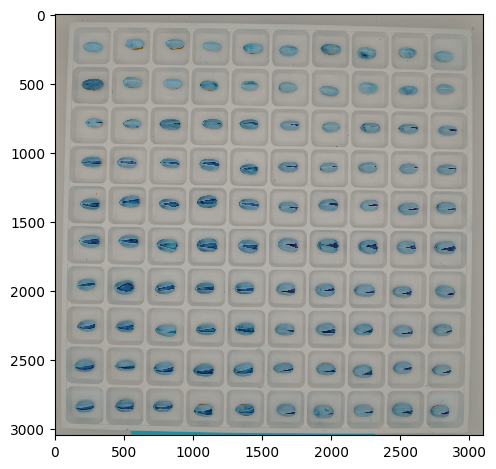

In [14]:
ad_image, image, image_path = load_and_preprocess_image(filepath, white_balance, adjust_brigtness_contrast, 
                                                lower_bound, upper_bound, brightness, contrast, show_image)
image_copy = deepcopy(image)
plot_multiple_imgs(imgs=[ad_image, image], labels = ['Adjusted Image', 'Original Image'])

In [ ]:


# Call the function with the variables
extract_pistachio_from_plate(
    filepath,
    adaptive_thresh,
    sorted_contours,
    cnt_width,
    cnt_height,
    white_balance,
    adjust_brigtness_contrast,
    lower_bound,
    upper_bound,
    brightness,
    contrast,
    padding,
    padding_percentage,
    save,
    show_image,
    sort_by_topmost,
    y_overlap_threshold,
    print_details,
    metadata
)